In [6]:
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np



In [7]:
scale_file = "test.wav"

In [8]:
ipd.Audio(scale_file)

In [9]:
#load audio files with librosa
scale, sr = librosa.load(scale_file)

## Mel Filter Banks

In [10]:
filter_banks = librosa.filters.mel(n_fft=2048, sr=22050, n_mels=10)

In [11]:
filter_banks.shape

(10, 1025)

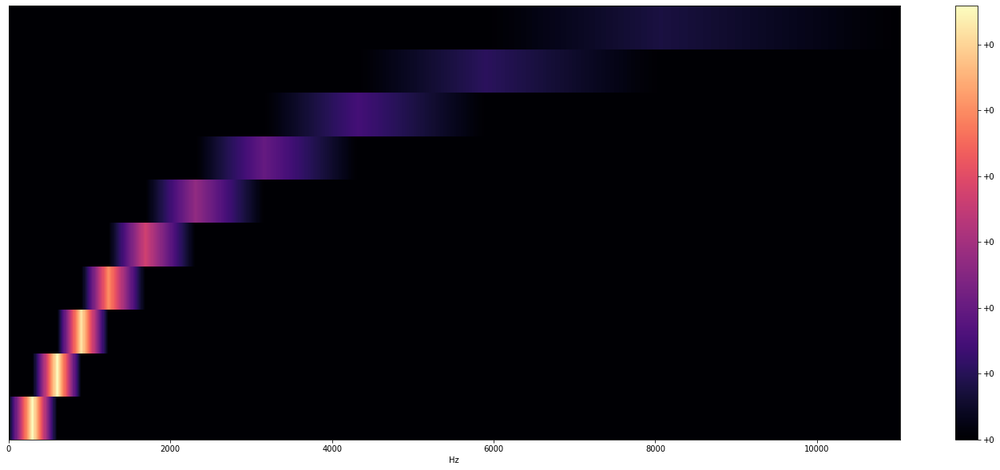

In [12]:
plt.figure(figsize=(25,10))
librosa.display.specshow(filter_banks,
                        sr=sr,
                        x_axis="linear")
plt.colorbar(format="%+2.f")
plt.show()

## Extracting Mel Spectogram

In [51]:
mel_spectrogram = librosa.feature.melspectrogram(scale, sr=sr, n_fft=2048, hop_length=512, n_mels=300)

In [52]:
mel_spectrogram.shape

(300, 4915)

In [53]:
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)

In [54]:
log_mel_spectrogram.shape

(300, 4915)

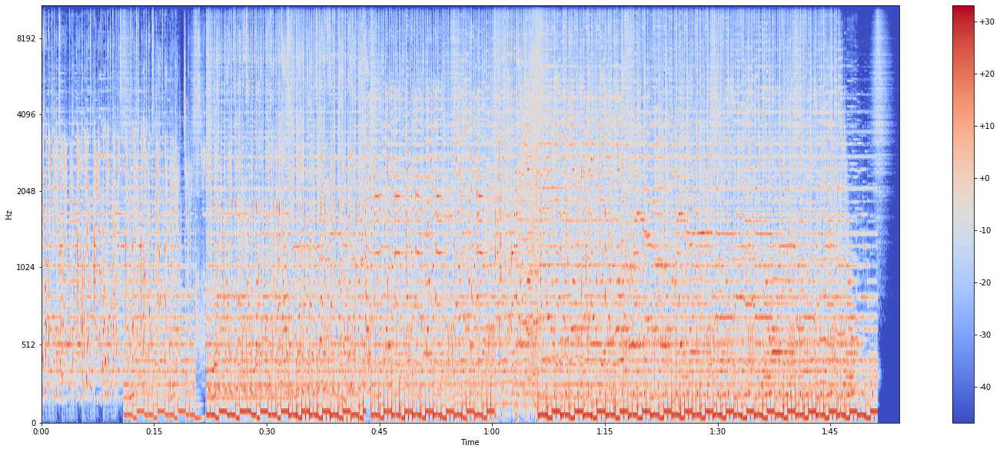

In [55]:
plt.figure(figsize=(25,10))
librosa.display.specshow(log_mel_spectrogram,
                        x_axis="time",
                        y_axis="mel",
                        sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

In [56]:
print(log_mel_spectrogram)

[[-46.899178 -32.486443 -25.316399 ... -46.899178 -46.899178 -46.899178]
 [-46.899178 -29.442547 -20.724363 ... -46.899178 -46.899178 -46.899178]
 [-46.899178 -28.475    -19.459442 ... -46.899178 -46.899178 -46.899178]
 ...
 [-46.899178 -46.899178 -41.00727  ... -46.899178 -46.899178 -46.899178]
 [-46.899178 -46.899178 -46.899178 ... -46.899178 -46.899178 -46.899178]
 [-46.899178 -46.899178 -46.899178 ... -46.899178 -46.899178 -46.899178]]


In [61]:
import cv2
#print(log_mel_spectrogram)
maxval = max([max(x) for x in log_mel_spectrogram])
minval = min([min(x) for x in log_mel_spectrogram])
diff = maxval-minval

print(maxval, minval)

for x in log_mel_spectrogram:
    for i in range(len(x)):
        x[i] = 255*(x[i]-minval)/diff

cv2.imwrite('img.jpg', log_mel_spectrogram)
img = cv2.imread('img.jpg', cv2.IMREAD_GRAYSCALE)
img = cv2.resize(img, (50, 50))
cv2.imwrite('img.jpg', img)


255.0 0.0


True